In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
from collections import namedtuple
from src.maze import MazeEnv
import matplotlib.animation as animation
from IPython.display import HTML, display

In [2]:
class Perception(nn.Module):
    def __init__(self, shape: tuple[int, int], action_space: int = 4) -> None:
        super().__init__()
        w, h = shape
        k, p, s = 2, 1, 2

        self.cn1 = nn.Conv2d(1, 8, k, s, p)
        w, h = self._conv_output_size(w, h, k, s, p)
        self.cn2 = nn.Conv2d(8, 32, k, s, p)
        w, h = self._conv_output_size(w, h, k, s, p)

        self.fc1 = nn.Linear(32 * w * h, action_space * 16)

    def _conv_output_size(self, w, h, k, s, p):
        w = (w - k + 2 * p) // s + 1
        h = (h - k + 2 * p) // s + 1
        return w, h

    def forward(self, img: torch.Tensor) -> torch.Tensor:
        x = F.relu(self.cn1(img))
        x = F.relu(self.cn2(x))
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        return x


class Manager(nn.Module):
    def __init__(self, dilation, num_actions, device):
        super(Manager, self).__init__()

        hidden_size = num_actions * 16
        self.device = device  # Guardamos el dispositivo

        # Inicializar las memorias en el dispositivo correcto
        self.hx_memory = [
            torch.zeros(1, hidden_size, device=device) for _ in range(dilation)
        ]
        self.cx_memory = [
            torch.zeros(1, hidden_size, device=device) for _ in range(dilation)
        ]

        self.hidden_size = hidden_size
        self.horizon = dilation
        self.index = 0

        self.fc = nn.Linear(hidden_size, hidden_size)
        self.lstm = nn.LSTMCell(hidden_size, hidden_size)
        self.lstm.bias_ih.data.fill_(0)
        self.lstm.bias_hh.data.fill_(0)

        self.fc_critic1 = nn.Linear(hidden_size, 50)
        self.fc_critic2 = nn.Linear(50, 1)

    def forward(self, inputs):
        x, (hx, cx) = inputs
        x = F.relu(self.fc(x))

        hx_t_1 = self.hx_memory[self.index]
        cx_t_1 = self.cx_memory[self.index]

        hx, cx = self.lstm(x, (hx_t_1, cx_t_1))

        # Actualizar las memorias
        self.hx_memory[self.index] = hx
        self.cx_memory[self.index] = cx
        self.index = (self.index + 1) % self.horizon

        goal = cx
        value = F.relu(self.fc_critic1(goal))
        value = self.fc_critic2(value)

        goal_norm = torch.norm(goal, p=2, dim=1).unsqueeze(1)
        goal = goal / goal_norm.detach()
        return goal, (hx, cx), value, x


class Worker(nn.Module):
    def __init__(self, num_actions, device):
        super(Worker, self).__init__()
        self.num_actions = num_actions
        self.device = device  # Guardamos el dispositivo

        self.lstm = nn.LSTMCell(num_actions * 16, num_actions * 16)
        self.lstm.bias_ih.data.fill_(0)
        self.lstm.bias_hh.data.fill_(0)

        self.fc = nn.Linear(num_actions * 16, 16, bias=False)

        self.fc_critic1 = nn.Linear(num_actions * 16, 50)
        self.fc_critic1_out = nn.Linear(50, 1)

        self.fc_critic2 = nn.Linear(num_actions * 16, 50)
        self.fc_critic2_out = nn.Linear(50, 1)

        # Inicializar parámetros en el dispositivo correcto
        self.hx_memory = torch.zeros(1, num_actions * 16, device=device)
        self.cx_memory = torch.zeros(1, num_actions * 16, device=device)

        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode="fan_out", nonlinearity="relu")

    def forward(self, inputs):
        x, (hx, cx), goals = inputs
        hx, cx = self.lstm(x, (hx, cx))

        value_ext = F.relu(self.fc_critic1(hx))
        value_ext = self.fc_critic1_out(value_ext)

        value_int = F.relu(self.fc_critic2(hx))
        value_int = self.fc_critic2_out(value_int)

        worker_embed = hx.view(hx.size(0), self.num_actions, 16)

        goals = goals.sum(dim=1)
        goal_embed = self.fc(goals.detach())
        goal_embed = goal_embed.unsqueeze(-1)

        policy = torch.bmm(worker_embed, goal_embed).squeeze(-1)
        policy = F.softmax(policy, dim=-1)
        return policy, (hx, cx), value_ext, value_int


class FuN(nn.Module):
    def __init__(self, shape, num_actions, horizon, device):
        super(FuN, self).__init__()
        self.horizon = horizon
        self.device = device

        self.percept = Perception(shape, num_actions).to(device)
        self.manager = Manager(self.horizon, num_actions, device).to(device)
        self.worker = Worker(num_actions, device).to(device)

    def forward(self, x, m_lstm, w_lstm, goals_horizon):
        percept_z = self.percept(x)

        goal, m_lstm, m_value, m_state = self.manager((percept_z, m_lstm))
        goals_horizon = torch.cat([goals_horizon[:, 1:], goal.unsqueeze(1)], dim=1)

        policy, (w_hx, w_cx), w_value_ext, w_value_int = self.worker(
            (percept_z, w_lstm, goals_horizon)
        )
        w_lstm = (w_hx, w_cx)
        return policy, goal, goals_horizon, m_lstm, w_lstm, m_value, w_value_ext

In [3]:
# Función para calcular los retornos acumulados
def compute_returns(rewards, gamma=0.99):
    returns = []
    R = 0
    for r in reversed(rewards):
        R = r + gamma * R
        returns.insert(0, R)
    return torch.tensor(returns, dtype=torch.float32)

In [4]:
# Definir el dispositivo
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Inicialización del entorno
env = MazeEnv((6, 6), False, 3, True, render_mode="rgb-array")
initial = (
    torch.tensor(env.reset(random_start=True), dtype=torch.float32)
    .unsqueeze(0)
    .unsqueeze(0)
    .to(device)
)

H, W = initial.shape[2], initial.shape[3]
num_actions = env.action_space.n
horizon = 9

# Inicializar la red FuN y llevarla al dispositivo
net = FuN((H, W), num_actions, horizon, device).to(device)
optimizer = torch.optim.RMSprop(net.parameters(), lr=0.00025, eps=0.01)

# Inicialización de memorias LSTM
m_hx = torch.zeros(1, num_actions * 16, device=device)
m_cx = torch.zeros(1, num_actions * 16, device=device)
w_hx = torch.zeros(1, num_actions * 16, device=device)
w_cx = torch.zeros(1, num_actions * 16, device=device)
goals_horizon = torch.zeros(1, horizon + 1, num_actions * 16, device=device)

score = 0

images = [env.render()]
real = False
goals = [1]

In [5]:
# Bucle de entrenamiento
loss_values_og = []
score_values_og = []
best_score = -30000
score = -30000
num_best_iteration = 0
for global_steps in range(500):
    state = (
        torch.tensor(env.reset(random_start=True), dtype=torch.float32)
        .unsqueeze(0)
        .unsqueeze(0)
        .to(device)
    )

    # Reiniciar memorias LSTM al inicio del episodio
    m_hx = torch.zeros(1, num_actions * 16, device=device)
    m_cx = torch.zeros(1, num_actions * 16, device=device)
    w_hx = torch.zeros(1, num_actions * 16, device=device)
    w_cx = torch.zeros(1, num_actions * 16, device=device)
    goals_horizon = torch.zeros(1, horizon + 1, num_actions * 16, device=device)

    done = False
    
    rewards = []
    policies = []
    values = []
    iterations = 0
    real = True
    if score > best_score:
        best_score = score
        best_iteration = images
        num_best_iteration = global_steps
    
    images = []
    goals = []
    score = 0
    
    while not done:
        # Obtener la política y el valor
        policy, goal, goals_horizon, m_lstm, w_lstm, m_value, w_value_ext = net(
            state, (m_hx, m_cx), (w_hx, w_cx), goals_horizon
        )

        goals.append(int(torch.max(goal)))

        # Actualizar memorias LSTM
        m_hx, m_cx = m_lstm
        w_hx, w_cx = w_lstm

        # Seleccionar acción
        action = torch.multinomial(policy.detach(), 1).item()

        # Almacenar política y valor para calcular la pérdida más adelante
        policies.append(policy[0, action])
        values.append(m_value.detach())

        # Tomar acción en el entorno
        next_state, reward, done, _, _ = env.step(action)
        rewards.append(reward)

        # Actualizar el estado
        state = (
            torch.tensor(next_state, dtype=torch.float32)
            .unsqueeze(0)
            .unsqueeze(0)
            .to(device)
        )

        score += reward
        iterations += 1
        if iterations > 2000:
            done = True
            real = False
        # env.render()
        images.append(env.render())

    # Calcular retornos acumulados
    returns = compute_returns(rewards).to(device)
    values = torch.cat(values).squeeze()

    # Calcular pérdidas
    policy_loss = 0
    value_loss = F.mse_loss(values.detach(), returns.detach())
    for log_prob, R, value in zip(policies, returns.detach(), values.detach()):
        advantage = R - value
        policy_loss += -log_prob * advantage.detach()  # Pérdida de política

    loss = policy_loss + 0.5 * value_loss

    # Retropropagación
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    loss_values_og.append(loss.item())
    score_values_og.append(score)

    print(f"Episode: {global_steps + 1} | Score: {score:.2f} | Loss: {loss.item():.4f}")

Episode: 1 | Score: -1059.00 | Loss: 29682.9258
Episode: 2 | Score: -1133.00 | Loss: 37190.2383
Episode: 3 | Score: -1932.00 | Loss: 88710.5938
Episode: 4 | Score: -1600.00 | Loss: 81501.9297
Episode: 5 | Score: -1194.00 | Loss: 31835.1582
Episode: 6 | Score: -896.00 | Loss: 22541.8164
Episode: 7 | Score: -1022.00 | Loss: 25644.0801
Episode: 8 | Score: -910.00 | Loss: 22839.8086
Episode: 9 | Score: -946.00 | Loss: 23690.6992
Episode: 10 | Score: -991.00 | Loss: 25661.8496
Episode: 11 | Score: -949.00 | Loss: 23683.4219
Episode: 12 | Score: -1013.00 | Loss: 25379.4902
Episode: 13 | Score: -1026.00 | Loss: 25960.0820
Episode: 14 | Score: -1012.00 | Loss: 25634.8145
Episode: 15 | Score: -1093.00 | Loss: 27465.1152
Episode: 16 | Score: -999.00 | Loss: 25171.1992
Episode: 17 | Score: -1010.00 | Loss: 25335.5176
Episode: 18 | Score: -1010.00 | Loss: 26139.8379
Episode: 19 | Score: -919.00 | Loss: 22850.6680
Episode: 20 | Score: -970.00 | Loss: 24862.0156
Episode: 21 | Score: -989.00 | Loss: 

Mejor iteracion:  140
animation created
animation saved


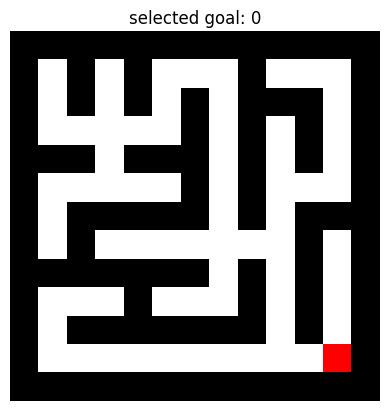

In [6]:
fig, ax = plt.subplots()
img = ax.imshow(best_iteration[0])
ax.axis("off")
title = ax.set_title("selected goal: ")
print("Mejor iteracion: ", num_best_iteration)


def animate(frame):
    img.set_array(best_iteration[frame])
    title.set_text(f"selected goal: {goals[frame]:1d}")
    return img, title


ani = animation.FuncAnimation(
    fig, animate, frames=len(best_iteration), interval=150, blit=True, repeat_delay=1000
)
print("animation created")

writer = animation.PillowWriter(
    fps=24, metadata=dict(artist="Rubén Cid, Aimar Nicuesa, Daniel Obreo"), bitrate=1800
)
ani.save(f"FuN_1.gif", writer=writer)
print("animation saved")

display(HTML(ani.to_jshtml(default_mode="once")))

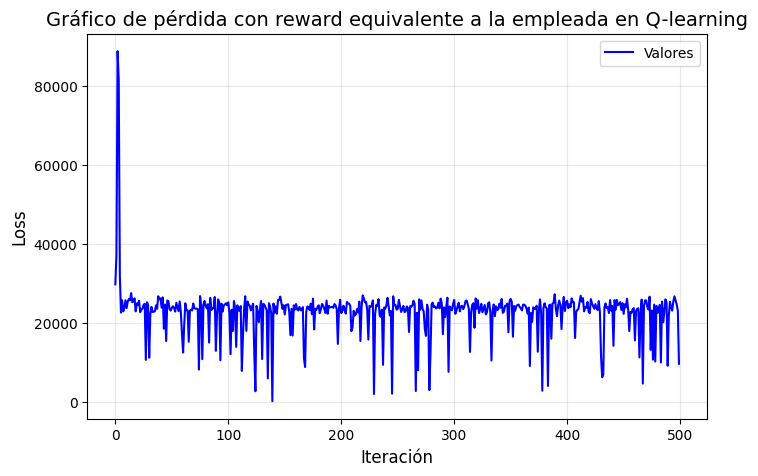

In [7]:
plt.figure(figsize=(8, 5))  # Tamaño del gráfico opcional
plt.plot(loss_values_og, linestyle='-', color='b', label='Valores')  # Linea con marcadores

# Etiquetas y título
plt.title("Gráfico de pérdida con reward equivalente a la empleada en Q-learning", fontsize=14)
plt.xlabel("Iteración", fontsize=12)
plt.ylabel("Loss", fontsize=12)

# Añadir una cuadrícula opcional y una leyenda
plt.grid(alpha=0.3)
plt.legend()

# Mostrar el gráfico
plt.show()

In [8]:
# Inicialización del entorno
env = MazeEnv((6, 6), False, 3, True, render_mode="rgb-array")
initial = (
    torch.tensor(env.reset(random_start=True), dtype=torch.float32)
    .unsqueeze(0)
    .unsqueeze(0)
    .to(device)
)

H, W = initial.shape[2], initial.shape[3]
num_actions = env.action_space.n
horizon = 9

# Inicializar la red FuN y llevarla al dispositivo
net = FuN((H, W), num_actions, horizon, device).to(device)
optimizer = torch.optim.RMSprop(net.parameters(), lr=0.00025, eps=0.01)

# Inicialización de memorias LSTM
m_hx = torch.zeros(1, num_actions * 16, device=device)
m_cx = torch.zeros(1, num_actions * 16, device=device)
w_hx = torch.zeros(1, num_actions * 16, device=device)
w_cx = torch.zeros(1, num_actions * 16, device=device)
goals_horizon = torch.zeros(1, horizon + 1, num_actions * 16, device=device)

score = 0

images = [env.render()]
real = False
goals = [1]

In [9]:
# Bucle de entrenamiento
loss_values_dist = []
score_values_dist = []
best_score = -30000
score = -30000
num_best_iteration = 0
for global_steps in range(500):
    state = (
        torch.tensor(env.reset(random_start=True), dtype=torch.float32)
        .unsqueeze(0)
        .unsqueeze(0)
        .to(device)
    )

    # Reiniciar memorias LSTM al inicio del episodio
    m_hx = torch.zeros(1, num_actions * 16, device=device)
    m_cx = torch.zeros(1, num_actions * 16, device=device)
    w_hx = torch.zeros(1, num_actions * 16, device=device)
    w_cx = torch.zeros(1, num_actions * 16, device=device)
    goals_horizon = torch.zeros(1, horizon + 1, num_actions * 16, device=device)

    done = False
    
    rewards = []
    policies = []
    values = []
    iterations = 0
    real = True
    if score > best_score:
        best_score = score
        best_iteration = images
        num_best_iteration = global_steps
    
    images = []
    goals = []
    score = 0
    while not done:
        # Obtener la política y el valor
        policy, goal, goals_horizon, m_lstm, w_lstm, m_value, w_value_ext = net(
            state, (m_hx, m_cx), (w_hx, w_cx), goals_horizon
        )

        goals.append(int(torch.max(goal)))

        # Actualizar memorias LSTM
        m_hx, m_cx = m_lstm
        w_hx, w_cx = w_lstm

        # Seleccionar acción
        action = torch.multinomial(policy.detach(), 1).item()

        # Almacenar política y valor para calcular la pérdida más adelante
        policies.append(policy[0, action])
        values.append(m_value.detach())

        # Encontrar el índice del valor máximo
        indice_max = torch.argmax(goal)

        # Convertir el índice plano a coordenadas (x, y)
        fila = indice_max // W  # División entera para obtener la fila
        columna = indice_max % W  # Resto de la división para obtener la columna

        # Guardar las coordenadas en variables
        coordenadas_goal = [fila, columna]
        # Tomar acción en el entorno
        next_state, reward, done, _, _ = env.step_proximity(action, coordenadas_goal)
        rewards.append(reward)

        # Actualizar el estado
        state = (
            torch.tensor(next_state, dtype=torch.float32)
            .unsqueeze(0)
            .unsqueeze(0)
            .to(device)
        )

        score += reward
        iterations += 1
        if iterations > 2000:
            done = True
            real = False
        # env.render()
        images.append(env.render())

    # Calcular retornos acumulados
    returns = compute_returns(rewards).to(device)
    values = torch.cat(values).squeeze()

    # Calcular pérdidas
    policy_loss = 0
    value_loss = F.mse_loss(values.detach(), returns.detach())
    for log_prob, R, value in zip(policies, returns.detach(), values.detach()):
        advantage = R - value
        policy_loss += -log_prob * advantage.detach()  # Pérdida de política

    loss = policy_loss + 0.5 * value_loss

    # Retropropagación
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    loss_values_dist.append(loss.item())
    score_values_dist.append(score)

    print(f"Episode: {global_steps + 1} | Score: {score:.2f} | Loss: {loss.item():.4f}")

Episode: 1 | Score: -13695.00 | Loss: 578176.5000
Episode: 2 | Score: -8331.00 | Loss: 324632.2812
Episode: 3 | Score: -4944.00 | Loss: 169911.6875
Episode: 4 | Score: -8251.00 | Loss: 272445.6250
Episode: 5 | Score: -8861.00 | Loss: 309019.6562
Episode: 6 | Score: -9449.00 | Loss: 343625.1875
Episode: 7 | Score: -14850.00 | Loss: 634487.1250
Episode: 8 | Score: -6418.00 | Loss: 215827.3438
Episode: 9 | Score: -12265.00 | Loss: 467611.3750
Episode: 10 | Score: -11960.00 | Loss: 471965.5312
Episode: 11 | Score: -13545.00 | Loss: 540155.9375
Episode: 12 | Score: -10698.00 | Loss: 387142.9375
Episode: 13 | Score: -6752.00 | Loss: 203545.4062
Episode: 14 | Score: -15683.00 | Loss: 665386.1250
Episode: 15 | Score: -10350.00 | Loss: 373621.7812
Episode: 16 | Score: -9734.00 | Loss: 357852.3750
Episode: 17 | Score: -13472.00 | Loss: 533731.3750
Episode: 18 | Score: -12630.00 | Loss: 489275.0000
Episode: 19 | Score: -15939.00 | Loss: 674143.6250
Episode: 20 | Score: -11978.00 | Loss: 452070.87

Mejor iteracion:  3
animation created
animation saved


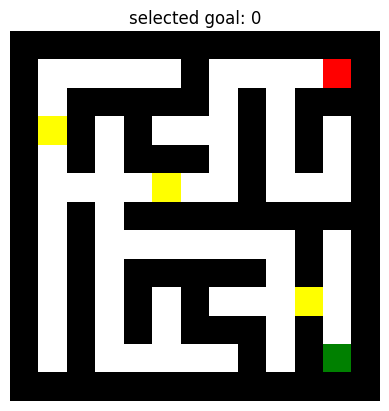

In [10]:
fig, ax = plt.subplots()
img = ax.imshow(best_iteration[0])
ax.axis("off")
title = ax.set_title("selected goal: ")
print("Mejor iteracion: ", num_best_iteration)


def animate(frame):
    img.set_array(best_iteration[frame])
    title.set_text(f"selected goal: {goals[frame]:1d}")
    return img, title


ani = animation.FuncAnimation(
    fig, animate, frames=len(best_iteration), interval=150, blit=True, repeat_delay=1000
)
print("animation created")

writer = animation.PillowWriter(
    fps=24, metadata=dict(artist="Rubén Cid, Aimar Nicuesa, Daniel Obreo"), bitrate=1800
)
ani.save(f"FuN_2.gif", writer=writer)
print("animation saved")

display(HTML(ani.to_jshtml(default_mode="once")))

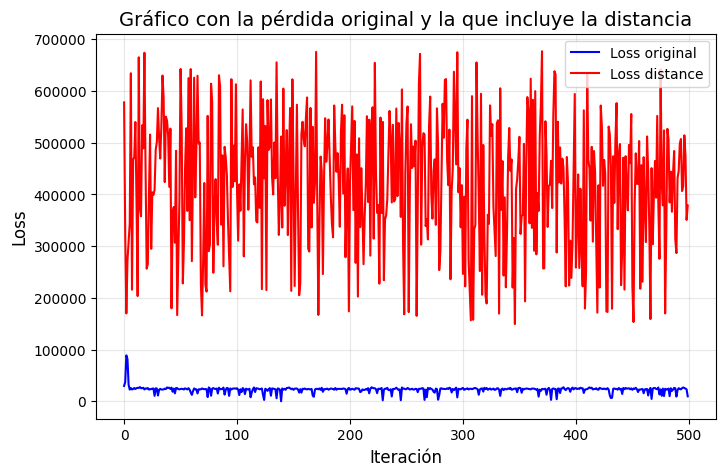

In [11]:
plt.figure(figsize=(8, 5))  # Tamaño del gráfico opcional
plt.plot(loss_values_og, linestyle='-', color='b', label='Loss original')  # Linea con marcadores
plt.plot(loss_values_dist, linestyle='-', color='r', label='Loss distance')  # Linea con marcadores

# Etiquetas y título
plt.title("Gráfico con la pérdida original y la que incluye la distancia", fontsize=14)
plt.xlabel("Iteración", fontsize=12)
plt.ylabel("Loss", fontsize=12)

# Añadir una cuadrícula opcional y una leyenda
plt.grid(alpha=0.3)
plt.legend()

# Mostrar el gráfico
plt.show()

In [12]:
# Inicialización del entorno
env = MazeEnv((6, 6), False, 3, True, render_mode="rgb-array")
initial = (
    torch.tensor(env.reset(random_start=True), dtype=torch.float32)
    .unsqueeze(0)
    .unsqueeze(0)
    .to(device)
)

H, W = initial.shape[2], initial.shape[3]
num_actions = env.action_space.n
horizon = 9

# Inicializar la red FuN y llevarla al dispositivo
net = FuN((H, W), num_actions, horizon, device).to(device)
optimizer = torch.optim.RMSprop(net.parameters(), lr=0.00025, eps=0.01)

# Inicialización de memorias LSTM
m_hx = torch.zeros(1, num_actions * 16, device=device)
m_cx = torch.zeros(1, num_actions * 16, device=device)
w_hx = torch.zeros(1, num_actions * 16, device=device)
w_cx = torch.zeros(1, num_actions * 16, device=device)
goals_horizon = torch.zeros(1, horizon + 1, num_actions * 16, device=device)

score = 0

images = [env.render()]
real = False
goals = [1]

In [13]:
# Bucle de entrenamiento
loss_values_all = []
score_values_all = []
best_score = -30000
score = -30000
num_best_iteration = 0
previous_states = []
previous_states.append(initial)
for global_steps in range(500):
    state = (
        torch.tensor(env.reset(random_start=True), dtype=torch.float32)
        .unsqueeze(0)
        .unsqueeze(0)
        .to(device)
    )

    # Reiniciar memorias LSTM al inicio del episodio
    m_hx = torch.zeros(1, num_actions * 16, device=device)
    m_cx = torch.zeros(1, num_actions * 16, device=device)
    w_hx = torch.zeros(1, num_actions * 16, device=device)
    w_cx = torch.zeros(1, num_actions * 16, device=device)
    goals_horizon = torch.zeros(1, horizon + 1, num_actions * 16, device=device)

    done = False
    
    rewards = []
    policies = []
    values = []
    iterations = 0
    real = True
    if score > best_score:
        best_score = score
        best_iteration = images
        num_best_iteration = global_steps
    
    images = []
    goals = []
    score = 0
    while not done:
        # Obtener la política y el valor
        policy, goal, goals_horizon, m_lstm, w_lstm, m_value, w_value_ext = net(
            state, (m_hx, m_cx), (w_hx, w_cx), goals_horizon
        )

        goals.append(int(torch.max(goal)))

        # Actualizar memorias LSTM
        m_hx, m_cx = m_lstm
        w_hx, w_cx = w_lstm

        # Seleccionar acción
        action = torch.multinomial(policy.detach(), 1).item()

        # Almacenar política y valor para calcular la pérdida más adelante
        policies.append(policy[0, action])
        values.append(m_value.detach())

        # Encontrar el índice del valor máximo
        indice_max = torch.argmax(goal)

        # Convertir el índice plano a coordenadas (x, y)
        fila = indice_max // W  # División entera para obtener la fila
        columna = indice_max % W  # Resto de la división para obtener la columna

        # Guardar las coordenadas en variables
        coordenadas_goal = [fila, columna]
        # Tomar acción en el entorno
        next_state, reward, done, _, _ = env.step_all(action, coordenadas_goal, previous_states)
        rewards.append(reward)
        previous_states.append(next_state)

        # Actualizar el estado
        state = (
            torch.tensor(next_state, dtype=torch.float32)
            .unsqueeze(0)
            .unsqueeze(0)
            .to(device)
        )

        score += reward
        iterations += 1
        if iterations > 2000:
            done = True
            real = False
        # env.render()
        images.append(env.render())

    # Calcular retornos acumulados
    returns = compute_returns(rewards).to(device)
    values = torch.cat(values).squeeze()

    # Calcular pérdidas
    policy_loss = 0
    value_loss = F.mse_loss(values.detach(), returns.detach())
    for log_prob, R, value in zip(policies, returns.detach(), values.detach()):
        advantage = R - value
        policy_loss += -log_prob * advantage.detach()  # Pérdida de política

    loss = policy_loss + 0.5 * value_loss

    # Retropropagación
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    loss_values_all.append(loss.item())
    score_values_all.append(score)

    print(f"Episode: {global_steps + 1} | Score: {score:.2f} | Loss: {loss.item():.4f}")

Episode: 1 | Score: -10534.00 | Loss: 427063.0312
Episode: 2 | Score: -8486.00 | Loss: 368931.8125
Episode: 3 | Score: -5093.00 | Loss: 202203.5938
Episode: 4 | Score: -3876.00 | Loss: 123868.7031
Episode: 5 | Score: -5502.00 | Loss: 180969.8438
Episode: 6 | Score: -6562.00 | Loss: 212692.7344
Episode: 7 | Score: -8917.00 | Loss: 315845.0625
Episode: 8 | Score: -7083.00 | Loss: 234432.5938
Episode: 9 | Score: -8532.00 | Loss: 293191.3750
Episode: 10 | Score: -9273.00 | Loss: 317352.3750
Episode: 11 | Score: -11144.00 | Loss: 430458.3750
Episode: 12 | Score: -8350.00 | Loss: 281083.1875
Episode: 13 | Score: -11233.00 | Loss: 413251.3125
Episode: 14 | Score: -9436.00 | Loss: 337697.9688
Episode: 15 | Score: -10632.00 | Loss: 376481.8438
Episode: 16 | Score: -14578.00 | Loss: 611160.1875
Episode: 17 | Score: -8631.00 | Loss: 300389.5000
Episode: 18 | Score: -15202.00 | Loss: 669180.4375
Episode: 19 | Score: -7605.00 | Loss: 256178.8125
Episode: 20 | Score: -10487.00 | Loss: 377163.9375
Ep

Mejor iteracion:  320
animation created
animation saved


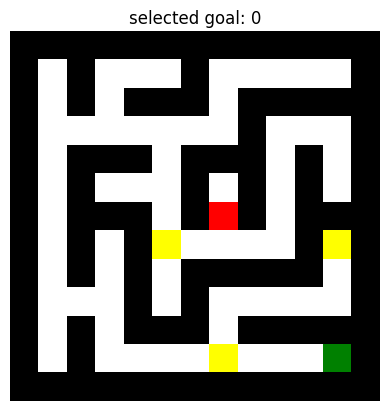

In [14]:
fig, ax = plt.subplots()
img = ax.imshow(best_iteration[0])
ax.axis("off")
title = ax.set_title("selected goal: ")
print("Mejor iteracion: ", num_best_iteration)


def animate(frame):
    img.set_array(best_iteration[frame])
    title.set_text(f"selected goal: {goals[frame]:1d}")
    return img, title


ani = animation.FuncAnimation(
    fig, animate, frames=len(best_iteration), interval=150, blit=True, repeat_delay=1000
)
print("animation created")

writer = animation.PillowWriter(
    fps=24, metadata=dict(artist="Rubén Cid, Aimar Nicuesa, Daniel Obreo"), bitrate=1800
)
ani.save(f"FuN_3.gif", writer=writer)
print("animation saved")

display(HTML(ani.to_jshtml(default_mode="once")))

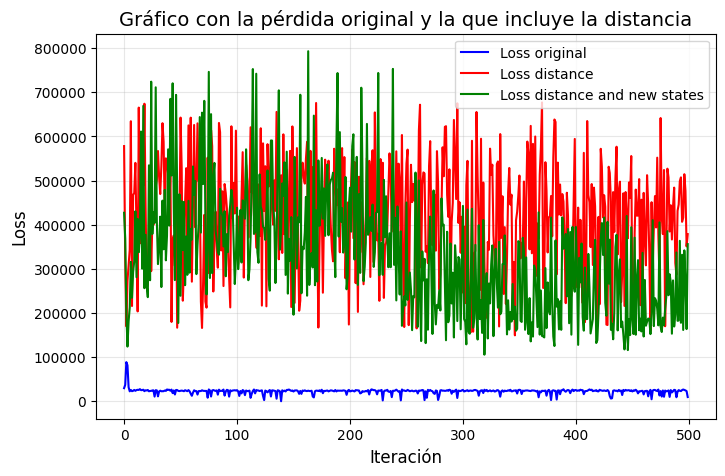

In [17]:
plt.figure(figsize=(8, 5))  # Tamaño del gráfico opcional
plt.plot(loss_values_og, linestyle='-', color='b', label='Loss original')  # Linea con marcadores
plt.plot(loss_values_dist, linestyle='-', color='r', label='Loss distance')  # Linea con marcadores
plt.plot(loss_values_all, linestyle='-', color='g', label='Loss distance and new states')  # Linea con marcadores

# Etiquetas y título
plt.title("Gráfico con la pérdida original y la que incluye la distancia", fontsize=14)
plt.xlabel("Iteración", fontsize=12)
plt.ylabel("Loss", fontsize=12)

# Añadir una cuadrícula opcional y una leyenda
plt.grid(alpha=0.3)
plt.legend()

# Mostrar el gráfico
plt.show()

In [16]:
# Bucle de entrenamiento
loss_values_all_2 = []
score_values_all_2 = []
best_score = -30000
score = -30000
num_best_iteration = 0
previous_states = []
previous_states.append(initial)
for global_steps in range(1000):
    state = (
        torch.tensor(env.reset(random_start=True), dtype=torch.float32)
        .unsqueeze(0)
        .unsqueeze(0)
        .to(device)
    )

    # Reiniciar memorias LSTM al inicio del episodio
    m_hx = torch.zeros(1, num_actions * 16, device=device)
    m_cx = torch.zeros(1, num_actions * 16, device=device)
    w_hx = torch.zeros(1, num_actions * 16, device=device)
    w_cx = torch.zeros(1, num_actions * 16, device=device)
    goals_horizon = torch.zeros(1, horizon + 1, num_actions * 16, device=device)

    done = False
    
    rewards = []
    policies = []
    values = []
    iterations = 0
    real = True
    if score > best_score:
        best_score = score
        best_iteration = images
        num_best_iteration = global_steps
    
    images = []
    goals = []
    score = 0
    while not done:
        # Obtener la política y el valor
        policy, goal, goals_horizon, m_lstm, w_lstm, m_value, w_value_ext = net(
            state, (m_hx, m_cx), (w_hx, w_cx), goals_horizon
        )

        goals.append(int(torch.max(goal)))

        # Actualizar memorias LSTM
        m_hx, m_cx = m_lstm
        w_hx, w_cx = w_lstm

        # Seleccionar acción
        action = torch.multinomial(policy.detach(), 1).item()

        # Almacenar política y valor para calcular la pérdida más adelante
        policies.append(policy[0, action])
        values.append(m_value.detach())

        # Encontrar el índice del valor máximo
        indice_max = torch.argmax(goal)

        # Convertir el índice plano a coordenadas (x, y)
        fila = indice_max // W  # División entera para obtener la fila
        columna = indice_max % W  # Resto de la división para obtener la columna

        # Guardar las coordenadas en variables
        coordenadas_goal = [fila, columna]
        # Tomar acción en el entorno
        next_state, reward, done, _, _ = env.step_all(action, coordenadas_goal, previous_states)
        rewards.append(reward)
        previous_states.append(next_state)

        # Actualizar el estado
        state = (
            torch.tensor(next_state, dtype=torch.float32)
            .unsqueeze(0)
            .unsqueeze(0)
            .to(device)
        )

        score += reward
        iterations += 1
        if iterations > 2000:
            done = True
            real = False
        # env.render()
        images.append(env.render())

    # Calcular retornos acumulados
    returns = compute_returns(rewards).to(device)
    values = torch.cat(values).squeeze()

    # Calcular pérdidas
    policy_loss = 0
    value_loss = F.mse_loss(values.detach(), returns.detach())
    for log_prob, R, value in zip(policies, returns.detach(), values.detach()):
        advantage = R - value
        policy_loss += -log_prob * advantage.detach()  # Pérdida de política

    loss = policy_loss + 0.5 * value_loss

    # Retropropagación
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    loss_values_all_2.append(loss.item())
    score_values_all_2.append(score)

    print(f"Episode: {global_steps + 1} | Score: {score:.2f} | Loss: {loss.item():.4f}")

Episode: 1 | Score: -6582.00 | Loss: 214290.3281
Episode: 2 | Score: -9296.00 | Loss: 326407.4375
Episode: 3 | Score: -5586.00 | Loss: 167738.0938
Episode: 4 | Score: -9504.00 | Loss: 330743.9375
Episode: 5 | Score: -6465.00 | Loss: 212199.3906
Episode: 6 | Score: -9279.00 | Loss: 326298.5625
Episode: 7 | Score: -10632.00 | Loss: 383933.4375
Episode: 8 | Score: -7455.00 | Loss: 244173.0938
Episode: 9 | Score: -7628.00 | Loss: 249145.5625
Episode: 10 | Score: -8108.00 | Loss: 276075.4062
Episode: 11 | Score: -8926.00 | Loss: 324651.3750
Episode: 12 | Score: -9940.00 | Loss: 345562.9375
Episode: 13 | Score: -9583.00 | Loss: 334156.3750
Episode: 14 | Score: -7855.00 | Loss: 270147.0312
Episode: 15 | Score: -10832.00 | Loss: 398510.6250
Episode: 16 | Score: -5385.00 | Loss: 161418.8438
Episode: 17 | Score: -5186.00 | Loss: 155565.6250
Episode: 18 | Score: -8846.00 | Loss: 316373.3750
Episode: 19 | Score: -8600.00 | Loss: 307158.0625
Episode: 20 | Score: -5741.00 | Loss: 185339.4844
Episode